# Game

In [10]:
import random


class Game:
    def __init__(self, x):
        self.board = (['R'] * x) + (['B'] * x) + (['G'] * (100 - (2*x)))
        
    def roll(self):
        return random.choice(self.board)

In [11]:
g = Game(30)

In [12]:
for _ in range(5):
    print(g.roll())

G
R
B
R
R


In [13]:
range_x = range(1, 50)
n_rounds = 1000
n_simulations = 1000

generated_data = []
for x in range_x:
    g = Game(x)
    sims = []
    for _ in range(n_simulations):
        sim = []
        for _ in range(n_rounds):
            sim.append(g.roll())
        sims.append(sim)
    generated_data.append(sims)

In [14]:
len(generated_data)

49

In [15]:
len(generated_data[0])

1000

In [16]:
len(generated_data[0][0])

1000

In [17]:
import json

with open('simulations_data.json', 'w') as f:
    json.dump(generated_data, f)

# Policies

In [18]:
from abc import ABC, abstractmethod

class BaseStrategy:
    def __init__(self):
        """
        Store the value of the step wise value of the strategy. 
        """
        self.history = [1000]
        
    def policy(self, tile):
        return self.history[-1]
    
    def play(self, tiles):
        for tile in tiles:
            new_value = self.policy(tile)
            self.history.append(new_value)
            if new_value <= 0:
                return

In [19]:
class ConstantRedBlack(BaseStrategy):
    def __init__(self):
        super().__init__()
        
    def policy(self, tile):
        last_value = self.history[-1]
        bet = 10
        if tile in 'RB':
            return last_value + (bet * 2)
        return last_value - bet
            


In [20]:
class DoublingRedBlack(BaseStrategy):
    def __init__(self):
        super().__init__()
        self.last_bet = 10
        
    def policy(self, tile):
        last_value = self.history[-1]
        bet = self.last_bet
        if bet > self.history[-1]:
            return 0
        
        if tile in 'RB':
            self.last_bet = 10
            return last_value + (bet * 2)
            
        self.last_bet *= 2
        return last_value - bet

In [21]:
class ConstantGreen(BaseStrategy):
    def __init__(self):
        super().__init__()
        
    def policy(self, tile):
        bet = 10
        if tile in 'G':
            return self.history[-1] + (bet * 18)
        return self.history[-1] - bet

In [22]:
class RandomBetting(BaseStrategy):
    def __init__(self):
        super().__init__()
        
    def policy(self, tile):
        bet_tile = random.choice(['R', 'G', 'B'])
        bet = 10
        if tile == bet_tile:
            return self.history[-1] + (bet)
        return self.history[-1] - bet

In [23]:
def play_strategy(Strategy:BaseStrategy, game_simulations):
    plt.figure()
    scores = []
    for sim in game_simulations:
        s = Strategy()
        s.play(sim)
        plt.plot(s.history)
        scores.append(s.history[-1])
    plt.show()
    return scores

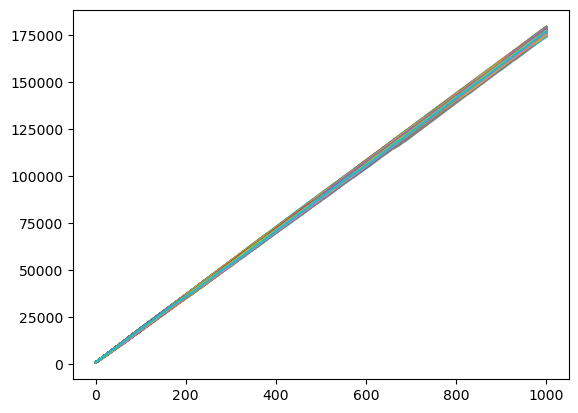

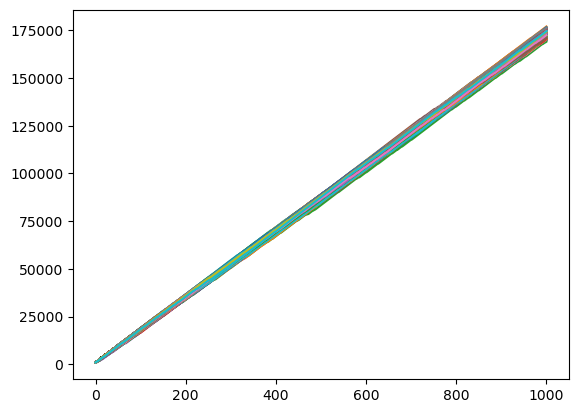

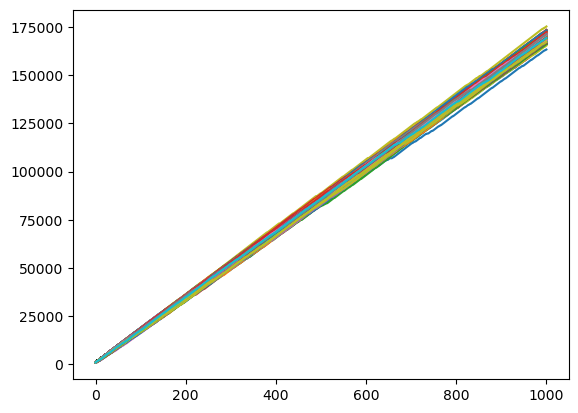

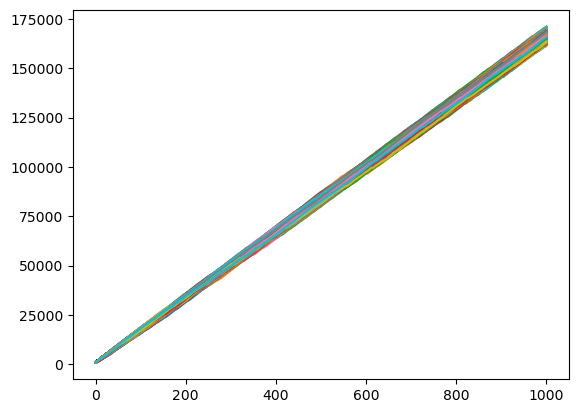

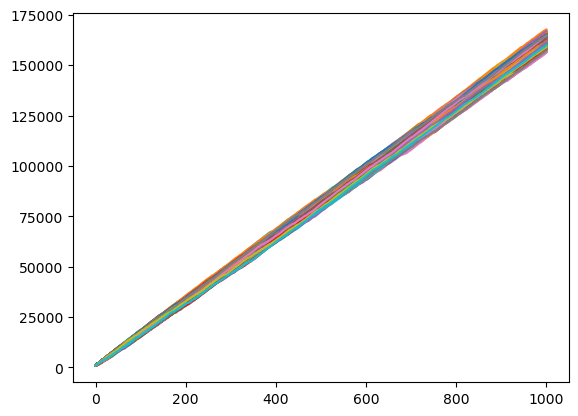

...

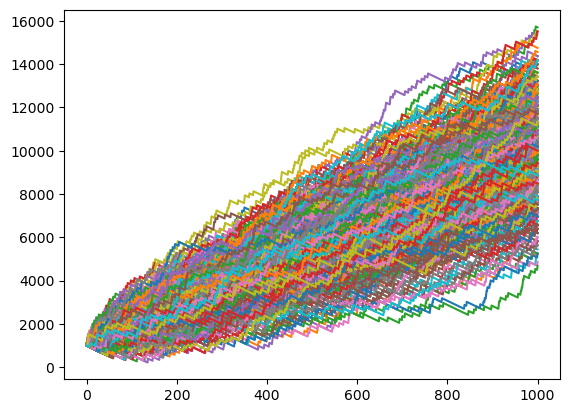

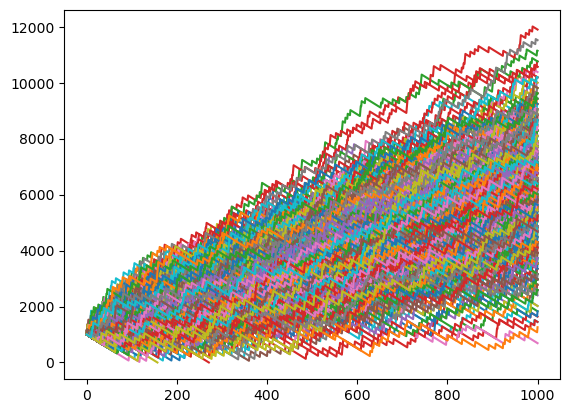

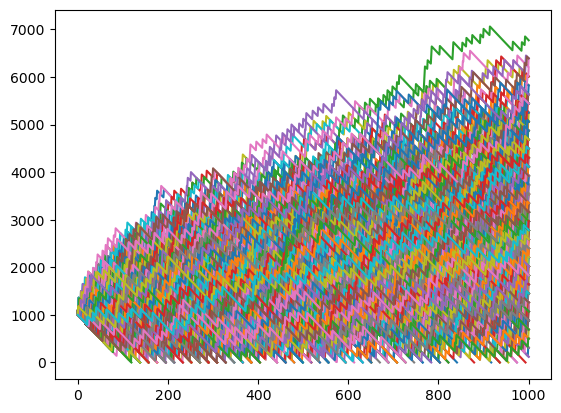

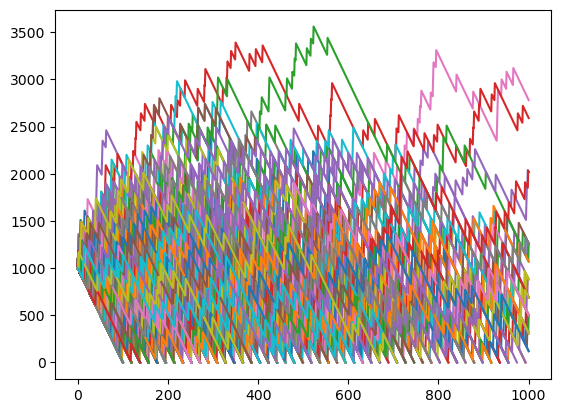

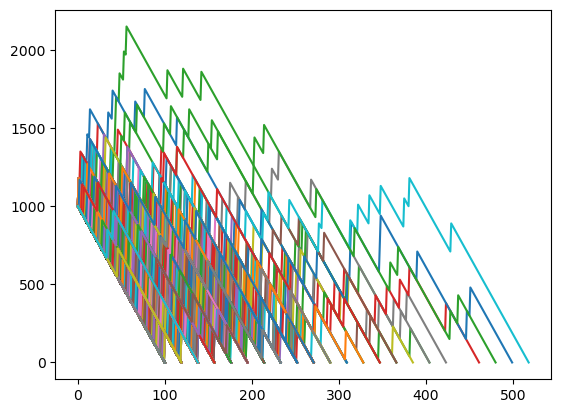

In [25]:
import matplotlib.pyplot as plt

f = open('constant_green.txt', 'w')
for i, game_sims in enumerate(generated_data, start=1):
    scores = play_strategy(ConstantGreen, game_sims)
    expectation = sum(scores) / len(scores)
    risk_of_ruin = scores.count(0) / len(scores)
    print(f'{i}: {expectation}, {risk_of_ruin}', file=f)
f.close()

plt.show()

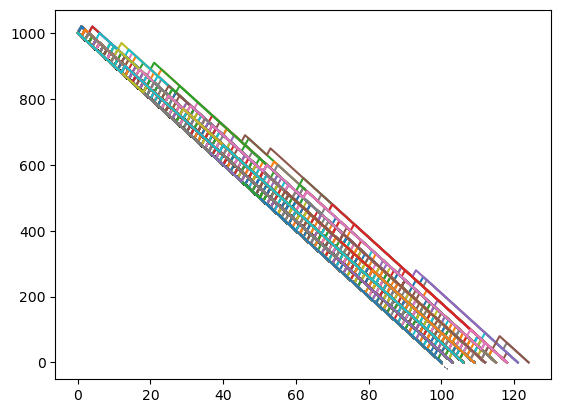

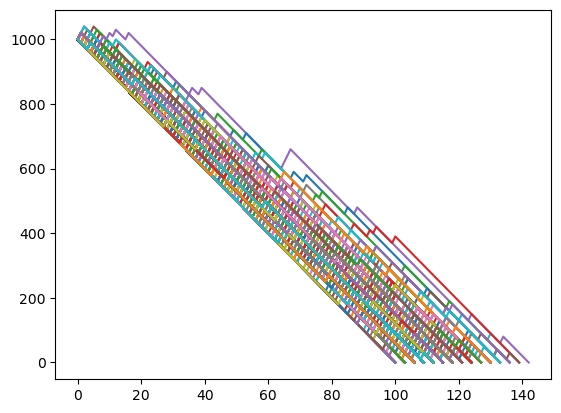

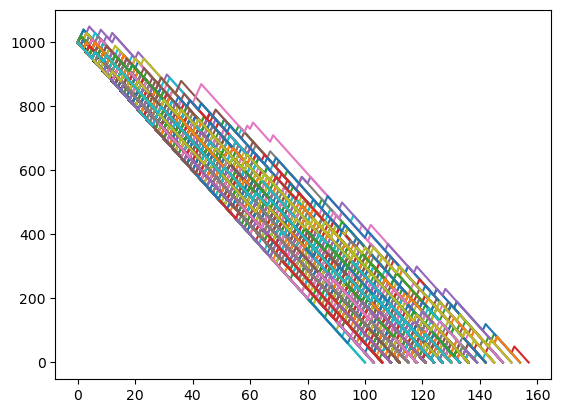

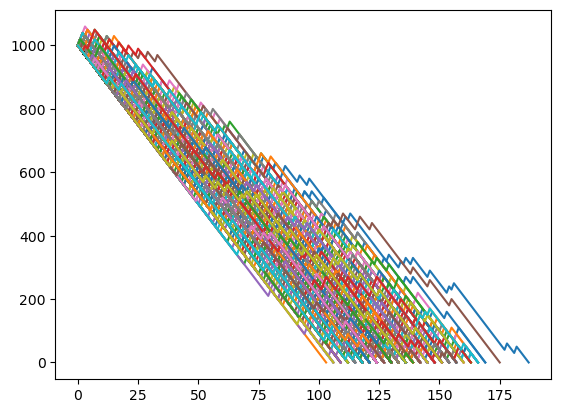

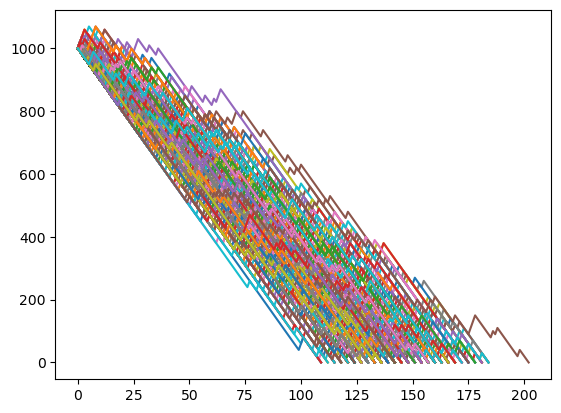

...

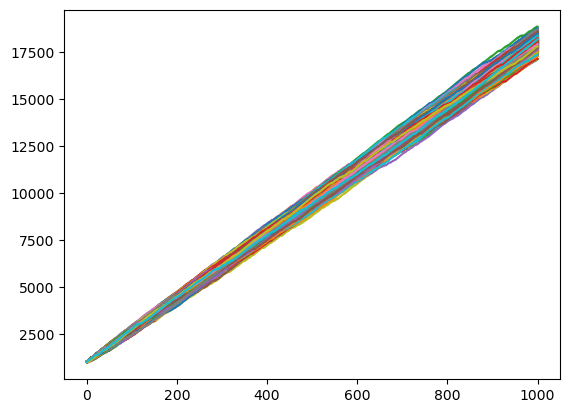

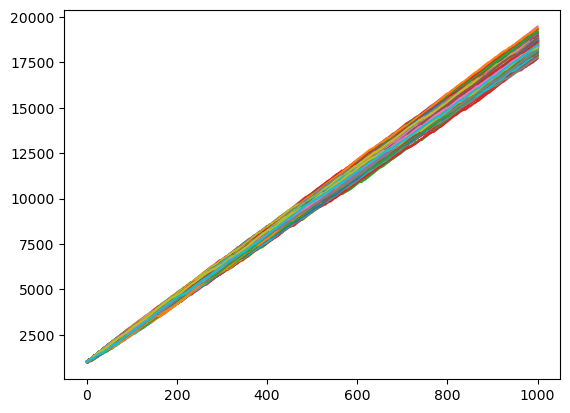

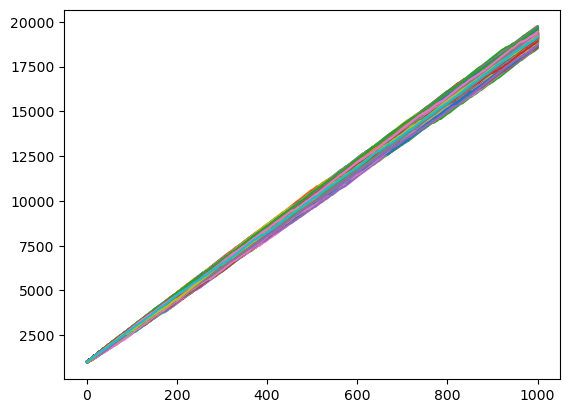

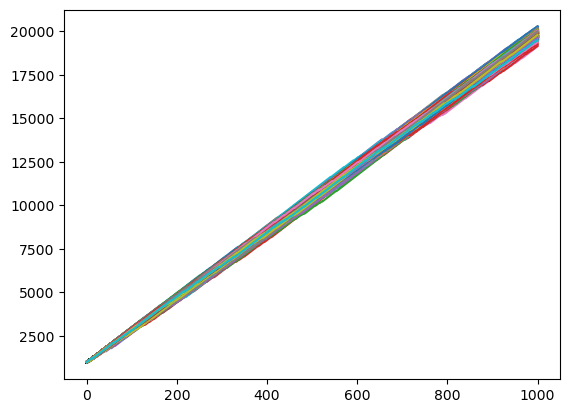

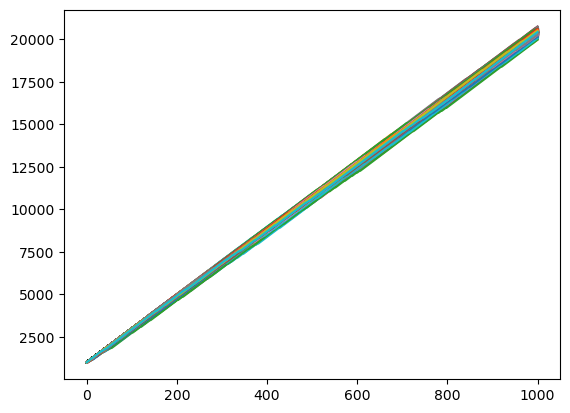

In [26]:
f = open('constant_redblack.txt', 'w')
for i, game_sims in enumerate(generated_data, start=1):
    scores = play_strategy(ConstantRedBlack, game_sims)
    expectation = sum(scores) / len(scores)
    risk_of_ruin = scores.count(0) / len(scores)
    print(f'{i}: {expectation}, {risk_of_ruin}', file=f)
f.close()

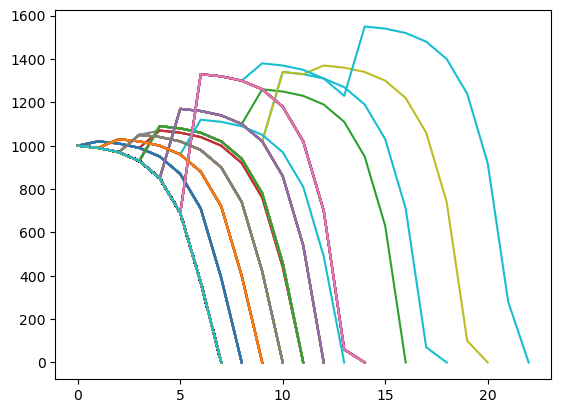

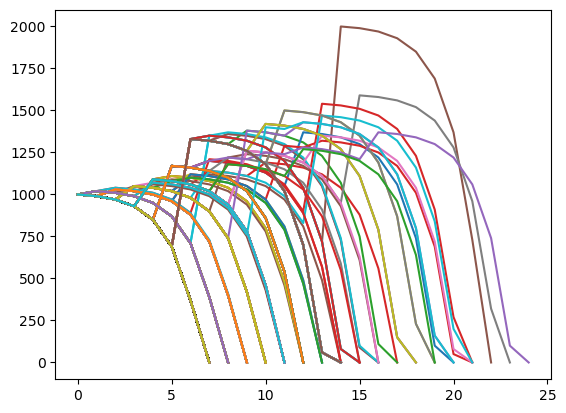

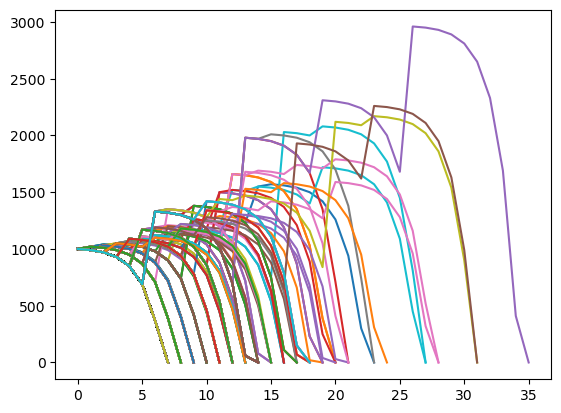

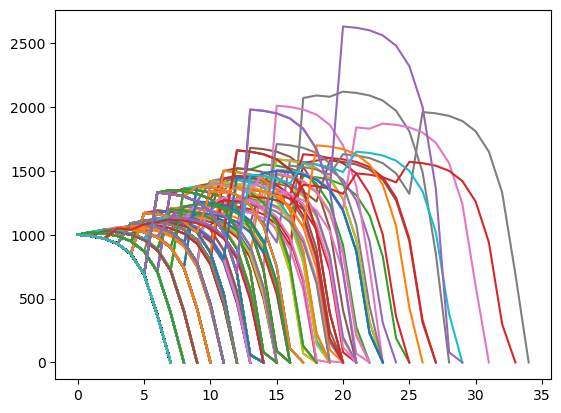

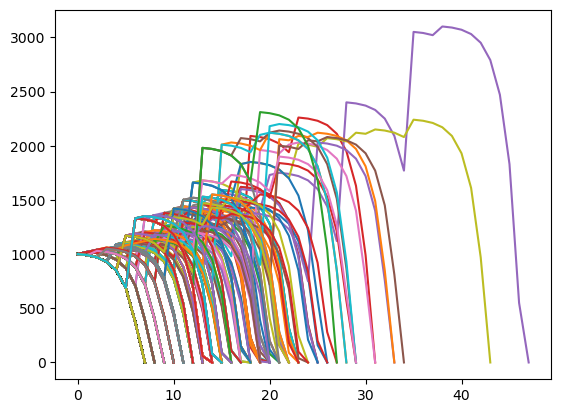

...

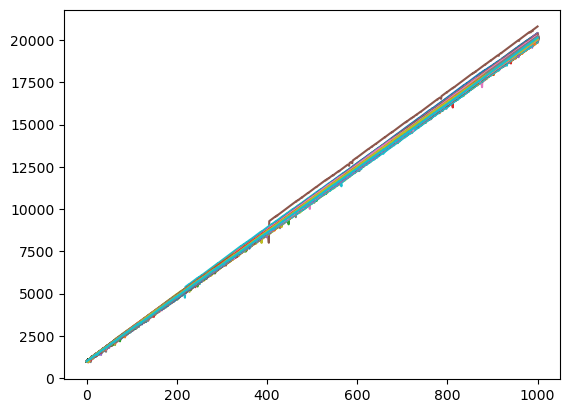

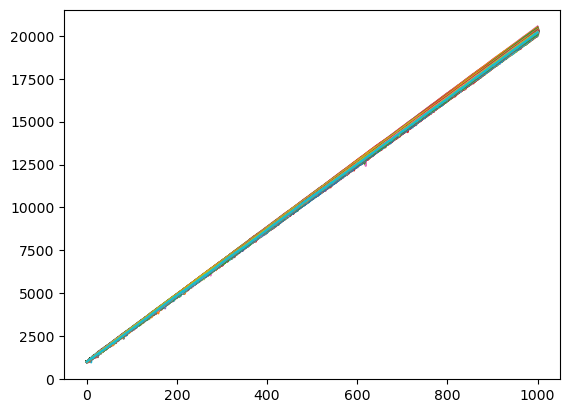

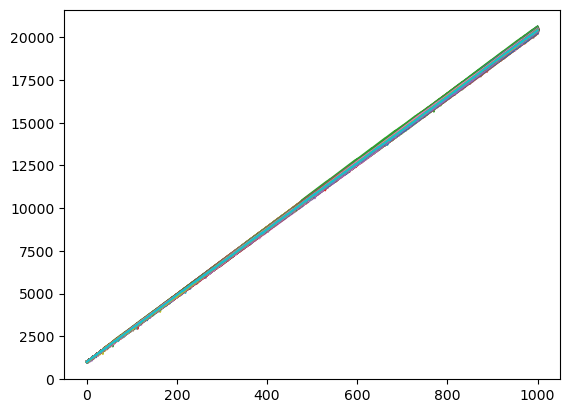

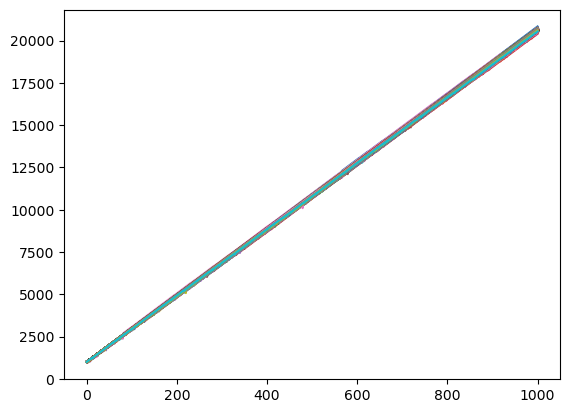

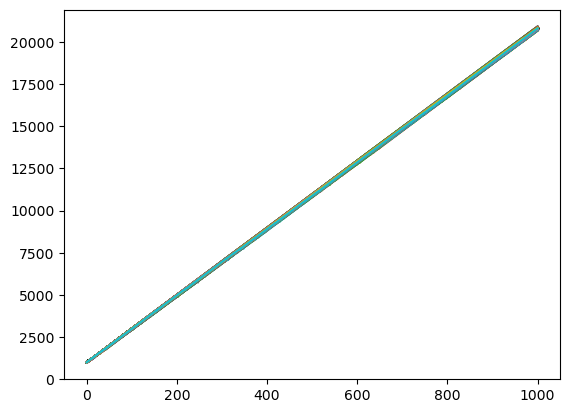

In [27]:
f = open('doubling_redblack.txt', 'w')
for i, game_sims in enumerate(generated_data, start=1):
    scores = play_strategy(DoublingRedBlack, game_sims)
    expectation = sum(scores) / len(scores)
    risk_of_ruin = scores.count(0) / len(scores)
    print(f'{i}: {expectation}, {risk_of_ruin}', file=f)
f.close()

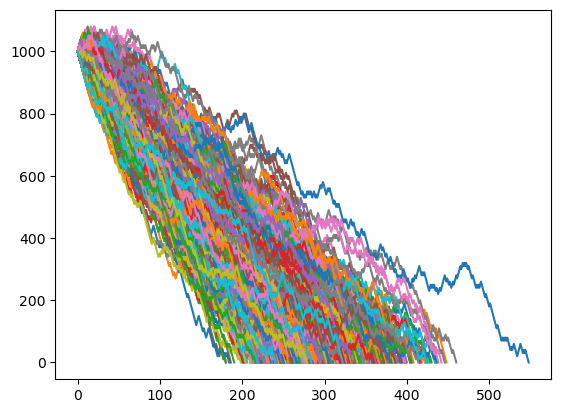

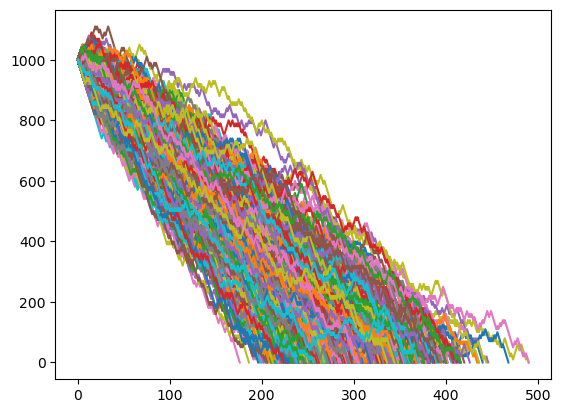

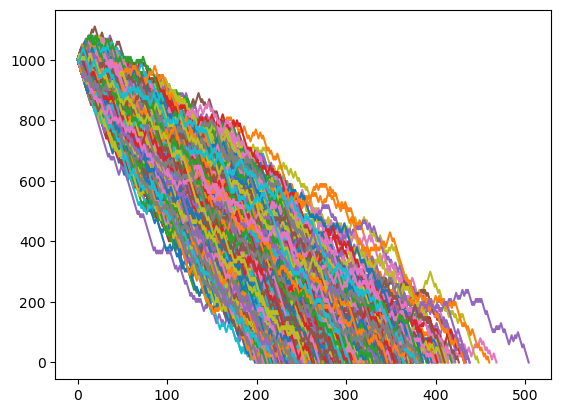

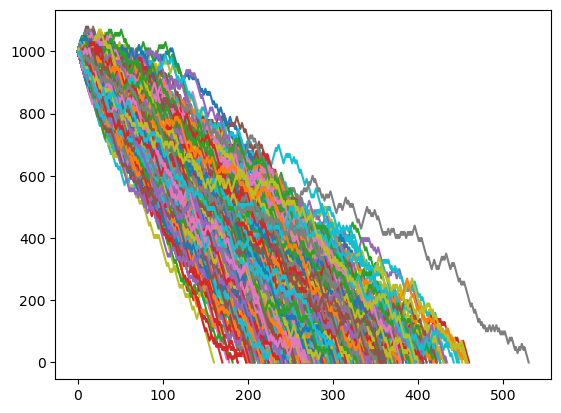

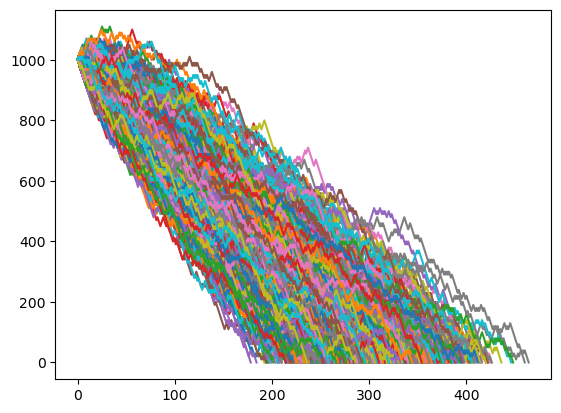

...

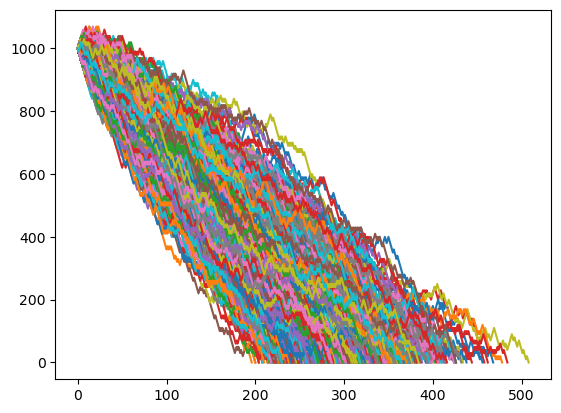

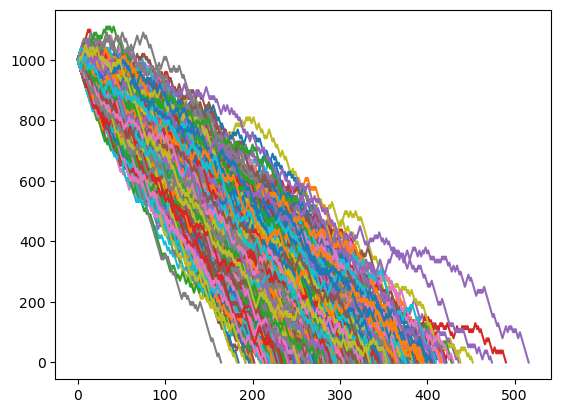

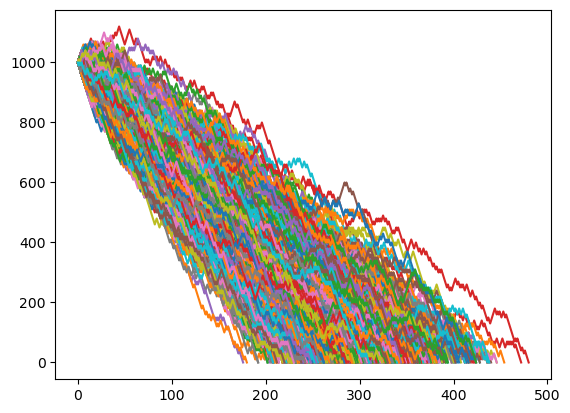

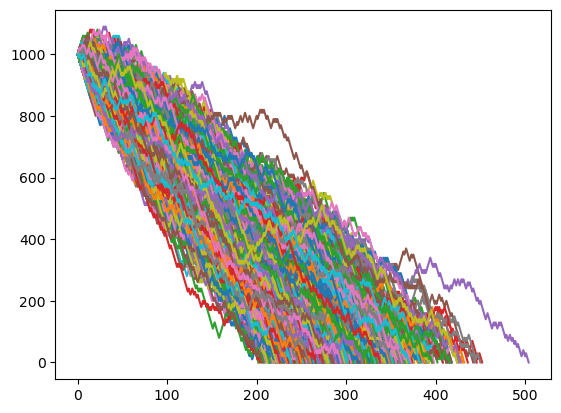

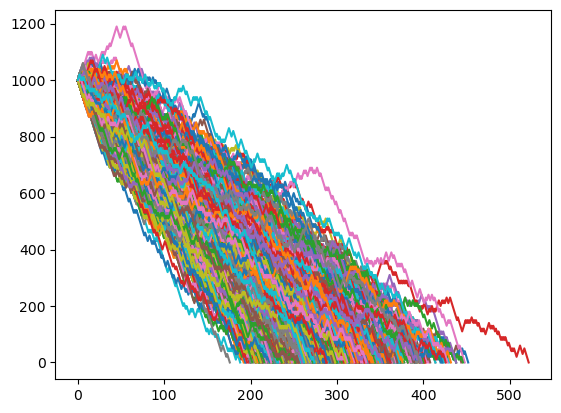

In [28]:
f = open('random_betting.txt', 'w')
for i, game_sims in enumerate(generated_data, start=1):
    scores = play_strategy(RandomBetting, game_sims)
    expectation = sum(scores) / len(scores)
    risk_of_ruin = scores.count(0) / len(scores)
    print(f'{i}: {expectation}, {risk_of_ruin}', file=f)
f.close()

In [29]:
import statistics

with open('constant_green.txt') as f:
    lines = f.readlines()
    lines = [line[line.index(':')+1:] for line in lines]

    lines = [eval(line) for line in lines]
    
    expected = statistics.mean(l[0] for l in lines)
    risk = statistics.mean(l[1] for l in lines)
    
    print(expected, risk)

86127.29959183674 0.04336734693877551


In [30]:
import statistics

with open('constant_redblack.txt') as f:
    lines = f.readlines()
    lines = [line[line.index(':')+1:] for line in lines]

    lines = [eval(line) for line in lines]
    
    expected = statistics.mean(l[0] for l in lines)
    risk = statistics.mean(l[1] for l in lines)
    
    print(expected, risk)

7290.208775510204 0.2987755102040816


In [31]:
import statistics

with open('doubling_redblack.txt') as f:
    lines = f.readlines()
    lines = [line[line.index(':')+1:] for line in lines]

    lines = [eval(line) for line in lines]
    
    expected = statistics.mean(l[0] for l in lines)
    risk = statistics.mean(l[1] for l in lines)
    
    print(expected, risk)

10126.142448979592 0.5323673469387755


In [32]:
import statistics

with open('random_betting.txt') as f:
    lines = f.readlines()
    lines = [line[line.index(':')+1:] for line in lines]

    lines = [eval(line) for line in lines]
    
    expected = statistics.mean(l[0] for l in lines)
    risk = statistics.mean(l[1] for l in lines)
    
    print(expected, risk)

0.0 1.0


We see that the strategy of betting a constant amount on Green has the highest expected payout, with the least overall risk of ruin. We note that Green has a significantly larger payout ratio as compared to Black and Red (18x, as compared to 2x), which may explain why some rounds last for longer in higher values of $x$. We note that as $x$ approaches 49, and the probability of green approaches 1-5%, more rounds go to failure before 1000 plays.

The strategy of betting a constant amount on either Red or Black has a low risk of ruin; with payout increasing as the value of $x$ increases. However, it is significantly lower than the previous strategy, due to the significantly lower payout ratio. 

In comparison, the strategy of doubling the bet on loss has a higher average payout, but also with an increased risk of ruin. Especially at lower values of $x$, we can see that betting can have catastrophic results as betting amount is doubled, and the overall loss is exponential.

At higher values of $x$, doubling the bet reliably annuls a previous loss, as the probability of losing continuously till failure is significantly lower. 

Random betting is not a reliable strategy, by virtue of its lack of predictability. None of our experiments ever reached the 1000th round, and failed earlier.  